# Run the Cells in this Order

1. Padding
2. Loading Images
3. Generate Cell Annotaion Files
4. Overlaying Cell Annotations on the Registered CODEX Image
5. Cell Extraction

Note: This requires you first to install the tifffile package.

In [1]:
import tifffile
import numpy as np
import warnings
warnings.filterwarnings("ignore")

def padding(input_filename = "TMA_3_cells.tif", output_filename = "TMA_3_cells_padded.tif" ):

    # open input image
    im = cv2.imread(input_filename,0)

    #print(im.shape)
    # get current image size and number of channels
    height, width = im.shape
    #print(im.shape)
    # specify target image size
    target_width = 28000
    target_height = 5000

    # calculate padding amounts
    pad_width = target_width - width
    pad_height = target_height - height
    #print(pad_width)
    #print(pad_height)
    # create new image with padding
    new_im = np.zeros((target_height, target_width))
    new_im[pad_height:target_height, pad_width:] = im[:, :target_width-pad_width]

    print(new_im.shape)
    #print(new_im)
    
    # save padded image
    new = Image.fromarray(new_im)
    new.save(output_filename)
    
    #fig = plt.figure(figsize=(80,80))
    #plt.imshow(new,cmap='gray')
    #plt.show()

In [2]:
# Functions to Generate the XML file.

# XML file contains all of the x,y coordinates that describes the contours of each cell.
# We can use this XML file to visualize how well the segmentations are on ImageScope Aperio Software.

# Note: The XML file and .SVS file should have the same filename when viewing it on the software. 
# (e.g. 213_Hive.xml & 213_Hive.svs)

# Also, once you have the XML file generated don't try changing the filename it would distort the data. 
# I am not sure why this is happening. 

In [3]:
import os
import cv2
import numpy as np
from PIL import Image
import lxml.etree as ET
from tqdm import tqdm

"""
xml_path (string) - the filename of the saved xml
mask (array) - the mask to convert to xml - uint8 array
downsample (int) - amount of downsampling done to the mask
                    points are upsampled - this can be used to simplify the mask
xml_color (list) - list of binary color values to be used for classes
"""

def mask_to_xml(xml_path, mask, downsample=1, xml_color=[65280, 65535, 33023, 255, 16711680], verbose=0):

    # create xml tree
    Annotations = xml_create()

    # get all classes
    classes = np.uint8(np.unique(mask)/255)

    # add annotation classes to tree
    for class_ in range(max(classes)+1)[1:]:
        if verbose:
            print('Creating class: [{}]'.format(class_))
        Annotations = xml_add_annotation(Annotations=Annotations, xml_color=xml_color, annotationID=class_)

    # add contour points to tree classwise
    for class_ in classes[1:]: # iterate through all classes

        if verbose:
            print('Working on class [{} of {}]'.format(class_, max(classes)))

        # binarize the mask w.r.t. class_
        #binaryMask = mask==class_

        # get contour points of the mask
        pointsList = get_contour_points(mask, downsample=downsample)
        for i in tqdm(range(np.shape(pointsList)[0])):
            pointList = pointsList[i]
            Annotations = xml_add_region(Annotations=Annotations, pointList=pointList, annotationID=class_)

    # save the final xml file
    xml_save(Annotations=Annotations, filename='{}.xml'.format(xml_path.split('.')[0]))

def get_contour_points(mask, downsample, min_area=50, offset={'X': 0,'Y': 0}):
    # returns a dict pointList with point 'X' and 'Y' values
    # input greyscale binary image
    maskPoints, contours = cv2.findContours(np.uint8(mask), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    count = 0
    pointsList = []
    for j in range(np.shape(maskPoints)[0]):
        area = cv2.contourArea(maskPoints[j])
        #print(maskPoints[j])
        if area < min_area:
            count+=1
            #print(count)
            continue
        pointList = []
        for i in range(0,np.shape(maskPoints[j])[0]):
            point = {'X': (maskPoints[j][i][0][0] * downsample) + offset['X'], 'Y': (maskPoints[j][i][0][1] * downsample) + offset['Y']}
            pointList.append(point)
        pointsList.append(pointList)
    print(count)
    return pointsList

### functions for building an xml tree of annotations ###
def xml_create(): # create new xml tree
    # create new xml Tree - Annotations
    Annotations = ET.Element('Annotations')
    return Annotations

def xml_add_annotation(Annotations, xml_color, annotationID=None): # add new annotation
    # add new Annotation to Annotations
    # defualts to new annotationID
    if annotationID == None: # not specified
        annotationID = len(Annotations.findall('Annotation')) + 1
    Annotation = ET.SubElement(Annotations, 'Annotation', attrib={'Type': '4', 'Visible': '1', 'ReadOnly': '0', 'Incremental': '0', 'LineColorReadOnly': '0', 'LineColor': str(xml_color[annotationID-1]), 'Id': str(annotationID), 'NameReadOnly': '0'})
    Regions = ET.SubElement(Annotation, 'Regions')
    return Annotations

def xml_add_region(Annotations, pointList, annotationID=-1, regionID=None): # add new region to annotation
    # add new Region to Annotation
    # defualts to last annotationID and new regionID
    Annotation = Annotations.find("Annotation[@Id='" + str(annotationID) + "']")
    Regions = Annotation.find('Regions')
    if regionID == None: # not specified
        regionID = len(Regions.findall('Region')) + 1
    Region = ET.SubElement(Regions, 'Region', attrib={'NegativeROA': '0', 'ImageFocus': '-1', 'DisplayId': '1', 'InputRegionId': '0', 'Analyze': '0', 'Type': '0', 'Id': str(regionID)})
    Vertices = ET.SubElement(Region, 'Vertices')
    for point in pointList: # add new Vertex
        ET.SubElement(Vertices, 'Vertex', attrib={'X': str(point['X']), 'Y': str(point['Y']), 'Z': '0'})
    # add connecting point
    ET.SubElement(Vertices, 'Vertex', attrib={'X': str(pointList[0]['X']), 'Y': str(pointList[0]['Y']), 'Z': '0'})
    return Annotations

def xml_save(Annotations, filename):
    xml_data = ET.tostring(Annotations, pretty_print=True)
    #xml_data = Annotations.toprettyxml()
    f = open(filename, 'w')
    f.write(xml_data.decode())
    f.close()

def read_xml(filename):
    # import xml file
    tree = ET.parse(filename)
    root = tree.getroot()

In [4]:
import os
import numpy as np
import cv2
#import xml.etree.ElementTree as ET
import lxml.etree as ET

def extract_cell(xml_file = "213_HIVE.xml",tif_file = "TMA_3.tif", patch_folder = "patch_folder", px=10):
    
    # Create patch_folder
    if not os.path.exists(patch_folder):
        os.makedirs(patch_folder)
    
    # Parse the XML file and extract the coordinates of the regions
    xml_file = "213_HIVE.xml"
    tree = ET.parse(xml_file)
    root = tree.getroot()

    regions = []
    for annotation in root.findall("Annotation"):
        if annotation.get("Type") == "4":
            for region in annotation.findall("Regions/Region"):
                coords = [vertex.attrib for vertex in region.findall("Vertices/Vertex")]
                regions.append(coords)

    # Load the large tif file into memory
    
    with tifffile.TiffFile(tif_file) as tif:
        # read all image data and metadata
        tif_image = tif.asarray()


    # Extract patches for each region
    for i, region in tqdm(enumerate(regions)):
        # Find the extreme points in the x and y axis, and add 10 pixels to each side
        x_coords = [int(coord["X"]) for coord in region]
        y_coords = [int(coord["Y"]) for coord in region]
        x_min, x_max = min(x_coords)-px, max(x_coords)+px
        y_min, y_max = min(y_coords)-px, max(y_coords)+px

        # Extract the patch from the large tif file using the computed coordinates
        patch = tif_image[:, y_min:y_max, x_min:x_max]
        #print(patch.shape)
        # Save the patch to a folder with the filename consisting of the image ID and its centroid
        image_id = annotation.get("Id")
        centroid_x = int(np.mean(x_coords))
        centroid_y = int(np.mean(y_coords))
        patch_filename = f"{image_id}_{centroid_x}_{centroid_y}.tif"
        
        patch_path = os.path.join(patch_folder, patch_filename)
        tifffile.imsave(patch_path, patch)

In [5]:
import tifffile
def tif_reader(tif_file):
    # load .tif files 
    img = tifffile.imread(tif_file)
    
    return img

In [6]:
import tifffile
import matplotlib.pyplot as plt
import lxml.etree as ET


def overlay(tif_path='TMA_3.tif', xml_path='213_HIVE1.xml'):
    # Load the TIF image
 
    image = tifffile.imread(tif_path)


    # Load the XML annotations
    tree = ET.parse(xml_path)
    root = tree.getroot()

    # Extract the vertices for each region
    vertices = []
    for region in root.iter('Region'):
        vertices.append([(int(vertex.get('X')), int(vertex.get('Y'))) for vertex in region.iter('Vertex')])
    
    # Plot the image and annotations
    fig = plt.figure(figsize=(100,100))
    plt.imshow(image[0])
    for verts in vertices:
        plt.fill([v[0] for v in verts], [v[1] for v in verts], 'r', alpha=0.3)

    plt.show()

   


# Padding

In [7]:
# TMA_3_cells.tif is the DAPI Mask
# TMA_3_cells_padded.tif will be saved on your CWD
padding(input_filename = "TMA_3_cells.tif", output_filename = "TMA_3_cells_padded.tif" )

(5000, 28000)


# Loading Images

In [8]:
# registered codex
reg_codex = tif_reader('TMA_3.tif')
print(reg_codex.shape)

(17, 5000, 28000)


In [9]:
# DAPI MASK
# NOTE: tif_reader function does not work when loading the DAPI MASK
dapi_mask = cv2.imread('TMA_3_cells.tif',0)
print(dapi_mask.shape)

(4888, 27513)


In [10]:
# unregistered codex
codex = tif_reader('codex.tif')
print(codex.shape)

(17, 14000, 2500)


In [11]:
# Padded DAPI Mask
padded_TMA_mask = tif_reader('TMA_3_cells_padded.tif')
print(padded_TMA_mask.shape)

(5000, 28000)


# Generate cell annotation file 

In [12]:
# Getting XML file for the original DAPI MASK (not padded)
# xml_path: XML filename
mask = np.uint8(dapi_mask)
mask_to_xml(xml_path='213_Hive.xml', mask=mask, downsample=1, xml_color=[65280, 65535, 33023, 255, 16711680], verbose=1)

Creating class: [1]
Working on class [1 of 1]
11653


100%|███████████████████████████████████████████████████████████████████████████| 20992/20992 [03:20<00:00, 104.70it/s]


In [13]:
# Getting XML file for the padded DAPI Mask
mask = np.uint8(padded_TMA_mask)
mask_to_xml(xml_path='213_Hive_Padded.xml', mask=mask, downsample=1, xml_color=[65280, 65535, 33023, 255, 16711680], verbose=1)

Creating class: [1]
Working on class [1 of 1]
11653


100%|███████████████████████████████████████████████████████████████████████████| 20992/20992 [03:19<00:00, 105.20it/s]


# Overlaying Cell Annotations on the Registered CODEX Image

#### Sanity Check

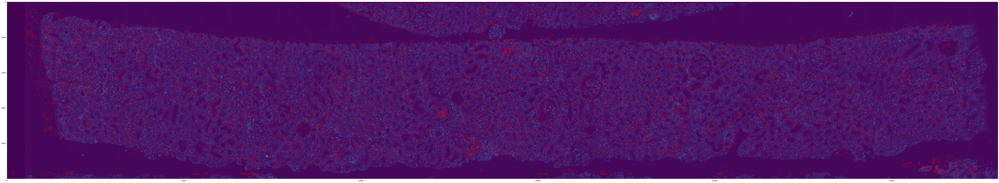

In [14]:
# before padding
overlay(tif_path='TMA_3.tif', xml_path='213_Hive.xml')                                                  

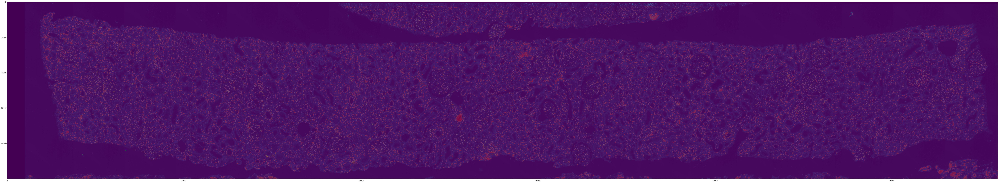

In [15]:
# after padding
overlay(tif_path='TMA_3.tif', xml_path='213_HIVE_Padded.xml')

# Cell Extraction

In [16]:
# Extracting Patches with 10px margin
extract_cell(xml_file ="213_Hive_Padded.xml",tif_file = "TMA_3.tif", patch_folder = "patch_folder_10px", px = 10)

20992it [00:27, 755.65it/s]


# Display All Channels

In [ ]:
import tifffile as tiff
import cv2
markers = ['DAPI','CD163','CK7','CD20 ','CD34 ','CD45','CD31 ','CD38','PanCK','Calbindin','CD68','Podoplanin','Coll4','SMA','Vimentin','AQP1','AQP2']
patch_path = './patch_folder/'
p = tiff.imread(patch_path)

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))

with tifffile.TiffFile('TMA_3.tif') as tif:
    # read all image data and metadata
    image = tif.asarray()
    metadata = tif.micromanager_metadata
    
    # extract and plot each channel
    
    for channel in range(image.shape[0]):
        plt.imshow(clahe.apply(image[channel]), cmap='gray')
        plt.title(f'{markers[channel]}')
        plt.axis('off')
        plt.show()


# Displaying All Channels for a Single Cell Sample

In [ ]:
import tifffile as tiff
import cv2
markers = ['DAPI','CD163','CK7','CD20 ','CD34 ','CD45','CD31 ','CD38','PanCK','Calbindin','CD68','Podoplanin','Coll4','SMA','Vimentin','AQP1','AQP2']
p = tiff.imread('./patch_folder/1_20567_4884.tif')

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))



with tifffile.TiffFile('./patch_folder_10px/1_1431_1922.tif') as tif:
    # read all image data and metadata
    image = tif.asarray()
    metadata = tif.micromanager_metadata
    
    # extract and plot each channel
    
    for channel in range(image.shape[0]):
        plt.imshow(clahe.apply(image[channel]), cmap='gray')
        plt.title(f'{markers[channel]}')
        plt.axis('off')
        plt.show()

#rgb = np.stack((p[0], p[3], p[7]), axis=-1)
#plt.figure(figsize=(80,80))
#plt.imshow(rgb)
#plt.show()